In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
matplotlib.style.use("ggplot")

#These are just initializations

/usr/lib/python3/dist-packages/matplotlib/__init__.py:874: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


In [2]:
# Let's import the data from Quandal
url = r'https://www.quandl.com/api/v3/datasets/WIKI/AAPL.csv?auth_token=6xWqEGP2dPDaaK3TGKvY'
stock = pd.read_csv(url,parse_dates='Date')
stock.head()

,Date,Open,High,Low,Close,Volume,Ex-Dividend,Split Ratio,Adj. Open,Adj. High,Adj. Low,Adj. Close,Adj. Volume
0,2016-03-07,102.39,102.8300,100.96,101.87,35408621,0,1,102.39,102.8300,100.96,101.87,35408621
1,2016-03-04,102.37,103.7500,101.37,103.01,45731824,0,1,102.37,103.7500,101.37,103.01,45731824
2,2016-03-03,100.58,101.7099,100.45,101.50,35926793,0,1,100.58,101.7099,100.45,101.50,35926793
3,2016-03-02,100.51,100.8900,99.64,100.75,32756196,0,1,100.51,100.8900,99.64,100.75,32756196
4,2016-03-01,97.65,100.7700,97.42,100.53,49924837,0,1,97.65,100.7700,97.42,100.53,49924837


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f632f3e3588>,
       <matplotlib.axes._subplots.AxesSubplot object at 0x7f632f35ad68>], dtype=object)

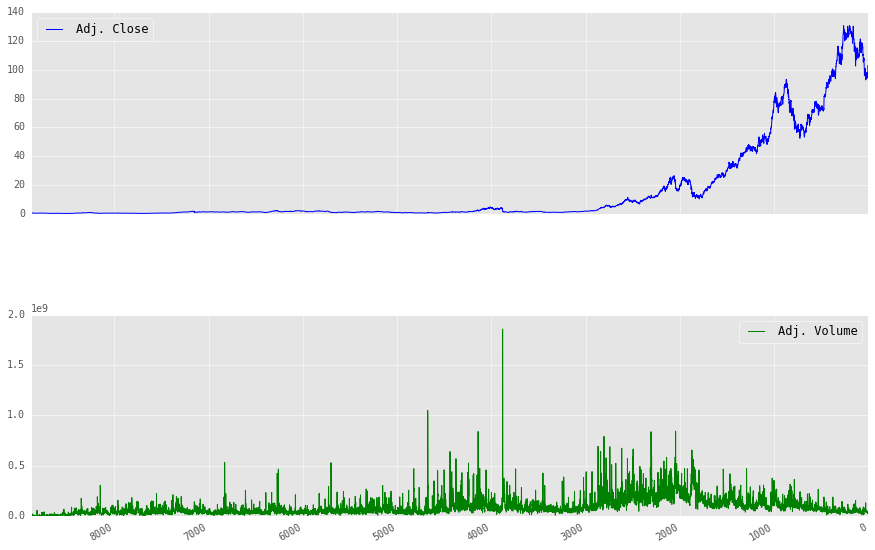

In [3]:
stock.loc[::-1,["Adj. Close", "Adj. Volume"]].plot(subplots=True, figsize = (15,10))

This is just the pandas plotting. Let's try the Bokeh plotting library.

In [52]:
from bokeh.plotting import show, output_notebook, figure
from bokeh.charts import Line, Bar, TimeSeries

In [5]:
output_notebook()


Loading BokehJS ...

In [39]:
stock.head()


,Date,Open,High,Low,Close,Volume,Ex-Dividend,Split Ratio,Adj. Open,Adj. High,Adj. Low,Adj. Close,Adj. Volume
0,2016-03-07,102.39,102.8300,100.96,101.87,35408621,0,1,102.39,102.8300,100.96,101.87,35408621
1,2016-03-04,102.37,103.7500,101.37,103.01,45731824,0,1,102.37,103.7500,101.37,103.01,45731824
2,2016-03-03,100.58,101.7099,100.45,101.50,35926793,0,1,100.58,101.7099,100.45,101.50,35926793
3,2016-03-02,100.51,100.8900,99.64,100.75,32756196,0,1,100.51,100.8900,99.64,100.75,32756196
4,2016-03-01,97.65,100.7700,97.42,100.53,49924837,0,1,97.65,100.7700,97.42,100.53,49924837


In [64]:
from bokeh.models import DatetimeTickFormatter
p=Line(stock.iloc[-1:-100:-1,], x='Date', y='Adj. Close', xlabel = 'test', xscale='datetime')
p.xaxis.formatter=DatetimeTickFormatter(formats=dict(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"],
    ))
show(p)

AttributeError: 'Chart' object has no attribute 'xaxis'

In [72]:
p=figure(x_axis_label = 'Date', x_axis_type = 'datetime')
p.line(x=np.arange(len(stock['Adj. Close'].tolist())),y=stock.iloc['Adj. Close'].tolist())
p.xaxis[0].major_label_text_font_size = '0pt'
show(p)

In [74]:
#p=figure(x_axis_label = 'Date', x_axis_type = 'datetime')
#p.line(stock['Date'],stock['Adj. Close'])
#p=Line(stock[1:100],x='Date', y = 'Adj. Close',xlabel='Date',xscale='datetime')
data = dict(AAPL=stock.iloc[-1:-100:-1,]['Adj. Close'], Date=stock.iloc[-1:-100:-1,]['Date'])
p=TimeSeries(data, x='Date')
p.xaxis[0].major_label_text_font_size = '0pt'
show(p)

AttributeError: 'Chart' object has no attribute 'xaxis'

In [7]:
stock.iloc[-1:,].head()

,Date,Open,High,Low,Close,Volume,Ex-Dividend,Split Ratio,Adj. Open,Adj. High,Adj. Low,Adj. Close,Adj. Volume
8883,1980-12-12,28.75,28.87,28.75,28.75,2093900,0,1,0.438717,0.440548,0.438717,0.438717,117258400


In [58]:
# Let's show the volume using the same scale

p=Bar(stock.iloc[-1:-100:-1,],label = 'Date', values="Adj. Volume", xscale = "datetime")
show(p)

### Everything above is to use the csv API from Quantle website. There should be a way to use the original JSON interface with request to get the data.

In [9]:
# Let's get the requests library into Python
import requests

In [10]:
stick = "AAPL"
url = "https://www.quandl.com/api/v3/datasets/WIKI/"
full_url = url + stick + '/' + 'data.json'
par = {'auth_token': '6xWqEGP2dPDaaK3TGKvY'}

stock_obj = requests.get(full_url, params = par)
full_url

'https://www.quandl.com/api/v3/datasets/WIKI/AAPL/data.json'

In [11]:
full_url
test = stock_obj.json()


In [12]:
# Convert JSON data into Pandas dataframe
stock = pd.DataFrame.from_dict(test['dataset_data']['data'])
stock.columns = test['dataset_data']['column_names']
stock.head()

,Date,Open,High,Low,Close,Volume,Ex-Dividend,Split Ratio,Adj. Open,Adj. High,Adj. Low,Adj. Close,Adj. Volume
0,2016-03-07,102.39,102.8300,100.96,101.87,35408621,0,1,102.39,102.8300,100.96,101.87,35408621
1,2016-03-04,102.37,103.7500,101.37,103.01,45731824,0,1,102.37,103.7500,101.37,103.01,45731824
2,2016-03-03,100.58,101.7099,100.45,101.50,35926793,0,1,100.58,101.7099,100.45,101.50,35926793
3,2016-03-02,100.51,100.8900,99.64,100.75,32756196,0,1,100.51,100.8900,99.64,100.75,32756196
4,2016-03-01,97.65,100.7700,97.42,100.53,49924837,0,1,97.65,100.7700,97.42,100.53,49924837


In [75]:
# A block of code for test

url = "https://www.quandl.com/api/v3/datasets/WIKI/"
  #full_url = url + app.vars['stock'] + '/' + 'data.json'
full_url = url + 'AAPL' + '/' + 'data.json'
par = {'auth_token': '6xWqEGP2dPDaaK3TGKvY'}
stock_obj = requests.get(full_url, params = par).json()
stock_data = pd.DataFrame.from_dict(stock_obj['dataset_data']['data'])
stock_data.columns = stock_obj['dataset_data']['column_names']
stock_data['Date'] = pd.to_datetime(stock_data['Date'])
## Now we have the data
## Let's construct Bokeh figure!
#plot = figure(title = 'Stock Data', x_axis_label = 'Date', x_axis_type = 'datetime')
#plot=Line(stock_data, x='Date', y=app.vars['columns'])
plot=Line(stock_data, x='Date', y='Adj. Close')
show(plot)